<a href="https://colab.research.google.com/github/AlissaDjema/TIDE/blob/master/scoring.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

In [4]:
data=pd.read_csv('ResiliationContratAuto.txt',dtype=object,encoding='latin1',delimiter="|")
data.head()

,NO_AFR,CDUSGAUT,IDECON,CD_AGT,CD_FML,CDPRGES,DTDBUCON,DTEFTMVT,MMJECHPP,MTPAATTC,AUTO4R,NOCLIGES,NUMFOY,CDMARVEH,DTOBTPDC,DTPMRMCI,LBMDLVH,NOTAREFF,PUI_TRE,RN_VL_VH,S_2_N,S_3_N,S_1_N,S_0_N,S_3_O,S_2_O,S_1_O,S_0_O,NIVBM,MTPAAREF,CDMCE,NBCTRES,ANCCLI,CD_CSP,CD_SEX,DT_NAI,CDSITFAM,DEPT,REGION,NBCTACT,AU4R,MH,DI,SA,IV,RESAU4R,RESMH,RESSA,RESIV,RESDI,CLIACTIF,U,CONTRAT,ETAT,MOTIFRSL,COEFCOMM,COEFPFLT,CRM
0,A00104001204707,611,205808992,A00104,R,4190A,14630,14812,0121,1929.66,O,11852135,11852135,PEUGEOT,10273,10683,205,BL050,D,05,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50,3833,P,0,14598,NaN,F,3639,M,01,RA,1,1,0,0,0,0,NaN,NaN,NaN,NaN,NaN,OUI,0.63063826581027,ACTIF,CO,NaN,100,0.85,50
1,A00104001270809,636,105939601,A00104,C,4190A,14701,14701,0401,4106.44,O,12024026,12024026,PEUGEOT,12877,11262,309,BL064,K,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,76,5991,P,0,14701,NaN,M,6093,M,01,RA,1,1,0,0,0,0,NaN,NaN,NaN,NaN,NaN,OUI,0.012900575535791,ACTIF,CO,NaN,100,0.75,76
2,A00104001397301,611,306115473,A00104,C,4190A,14848,14848,0826,4821.8,O,11154377,9064205,PEUGEOT,14196,9678,104,BL100,W,04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,95,4508,P,2,8866,NaN,M,-8391,M,01,RA,5,3,1,0,0,0,1,0,0,0,0,OUI,0.41777253310092,ACTIF,CO,NaN,100,0.9,95
3,A00104001402563,611,206122172,A00104,C,4190A,14861,14861,0908,9460.74,O,10342979,10342979,RENAULT,14629,11870,CLIO,BL100,K,10,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,95,9162,P,2,13872,NaN,M,7904,C,01,RA,1,1,0,0,0,0,1,0,0,0,0,OUI,0.5084374372421,ACTIF,CO,NaN,100,0.9,95
4,A00104716130632,603,35070,A00104,S,4190A,4018,14707,0407,1530.09,O,8826057,8289285,MERCEDES,NaN,5935,300D 12313010,BL064,G,15,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,50,3401,P,0,4018,NaN,M,-3633,M,01,RA,4,2,2,0,0,0,NaN,NaN,NaN,NaN,NaN,OUI,0.61543046106372,ACTIF,CO,NaN,91,0.8065,50


In [8]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90247 entries, 0 to 90246
Data columns (total 58 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   NO_AFR    90247 non-null  object
 1   CDUSGAUT  90231 non-null  object
 2   IDECON    90247 non-null  object
 3   CD_AGT    90247 non-null  object
 4   CD_FML    89702 non-null  object
 5   CDPRGES   90247 non-null  object
 6   DTDBUCON  90247 non-null  object
 7   DTEFTMVT  90247 non-null  object
 8   MMJECHPP  90231 non-null  object
 9   MTPAATTC  90247 non-null  object
 10  AUTO4R    90247 non-null  object
 11  NOCLIGES  90247 non-null  object
 12  NUMFOY    90247 non-null  object
 13  CDMARVEH  90160 non-null  object
 14  DTOBTPDC  90054 non-null  object
 15  DTPMRMCI  89315 non-null  object
 16  LBMDLVH   90137 non-null  object
 17  NOTAREFF  89980 non-null  object
 18  PUI_TRE   90081 non-null  object
 19  RN_VL_VH  90077 non-null  object
 20  S_2_N     9512 non-null   object
 21  S_3_N     80

In [6]:
#Les variables de date
date=data.columns[(data.columns.str.startswith("DT"))|(data.columns.str.startswith("ANCCLI"))]

#Les variables numérique
num_var=["U","CDUSGAUT","MTPAATTC","RN_VL_VH",
         "S_2_N","S_3_N","S_1_N","S_0_N",
         "S_3_O","S_2_O","S_1_O","S_0_O",
         "NIVBM","MTPAAREF","NBCTRES","ANCCLI",
         "NBCTACT","AU4R","MH","DI","SA","IV","RESAU4R",
         "RESMH","RESSA","RESIV","RESDI"]

On supprime :  MOTIFRSL CD_CSP AUTO4R LBMDLVH DEPT
Identifiants : NO_AFR IDECON (NUMFOY NOCLIGES)
Date bizarre : MMJECHPP

On peut calculer :
 - durée entre 1er contrat et contrat actuel (vraie ancienneté du client)
 - durée entre contrat et date du permis (ancienneté du permis à l'ouverture du contrat)
 - durée entre date de naissance et date du contrat (age de la personne à l'ouverture du contrat)
 - durée entre la mise en circulation et le début du contrat (ancienneté de la voiture)
 - Date de dédut de contrat (deja donnée)
 - Age au moment où il est devenu client
 
 
Pas de nomenclature pour les variables suivantes :

- CDPRGES ???
- ETAT ???
- U  ???   Score ??
- CLIACTIF (client actif) 
- MOTIFRSL (motif résiliation)  
- COEFCOMM (coef commision ???)  
- COEFPFLT  ???
- CRM   ??? Coefficient Réduction Majoration (CRM) ou Bonus Malus   == C'EST LA MEME CHOSE NIVBM 
- NO_AFR  ???  IDENTIFIANT
- NOCLIGES presque comme NUMFOY
- LBMDLVH : Modèle voiture

Pour traitement des valeurs manquantes 
On peut sommer le nombre de sinistres et/ou on peut aussi remplacer les NaN par des 0.
On peut croiser RESMH et MH pour traiter les valeurs maquante

NUMFOY Faire les groupes de famille

CD_FML peut-être regrouper les modalités (idem pour CDUSGAUT)

REGION assembler les regions 

On peut garder l'année de naissance 

In [9]:
data[num_var]=data[num_var].astype(float)
data[date]=data[date].astype(float)

In [10]:
for col in date:
    data[col]=pd.to_datetime(data[col], unit='D',errors='coerce',
               origin=pd.Timestamp('1960-01-01'))

In [11]:
Number_missing_value = data.isnull().sum()
percent_missing = data.isnull().sum() * 100 / len(data)
value_distinct = data.nunique()
info_type=data.dtypes
missing_value_df = pd.DataFrame({'value_disctinct':value_distinct,
                                 'Number_missing_value':Number_missing_value,
                                 'percent_missing': percent_missing,
                                 'type':info_type
                                })
missing_value_df

,value_disctinct,Number_missing_value,percent_missing,type
NO_AFR,90243,0,0.000000,object
CDUSGAUT,71,16,0.017729,float64
IDECON,90243,0,0.000000,object
CD_AGT,1255,0,0.000000,object
CD_FML,25,545,0.603898,object
CDPRGES,6,0,0.000000,object
DTDBUCON,8977,0,0.000000,datetime64[ns]
DTEFTMVT,1093,0,0.000000,datetime64[ns]
MMJECHPP,365,16,0.017729,object
MTPAATTC,79717,0,0.000000,float64


In [14]:
((missing_value_df[missing_value_df["percent_missing"]>=10]))

,value_disctinct,Number_missing_value,percent_missing,type
S_2_N,4,80735,89.460037,float64
S_3_N,5,82150,91.027957,float64
S_1_N,5,79468,88.056113,float64
S_0_N,4,79696,88.308753,float64
S_3_O,4,87332,96.769976,float64
S_2_O,3,86675,96.041974,float64
S_1_O,3,85963,95.253028,float64
S_0_O,3,85812,95.085709,float64
CD_CSP,234,39662,43.948275,object
RESAU4R,12,63741,70.629495,float64


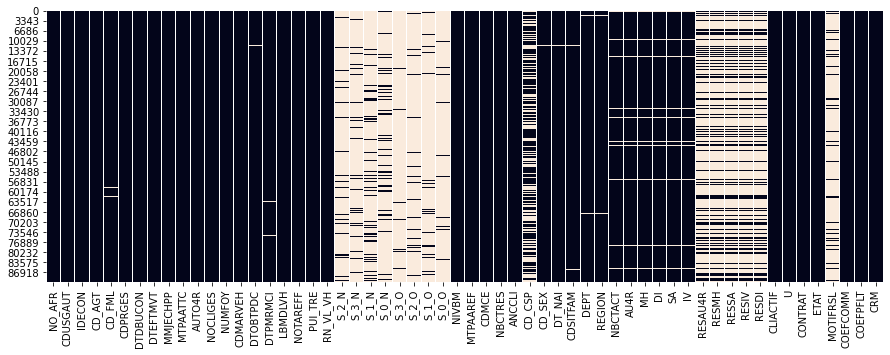

In [15]:
plt.figure(figsize=(15,5))
sns.heatmap(data.isnull(), cbar=False)

In [16]:
col_sinitre=data.columns[data.columns.str.startswith("S_")]
data[col_sinitre]=data[col_sinitre].fillna(0)

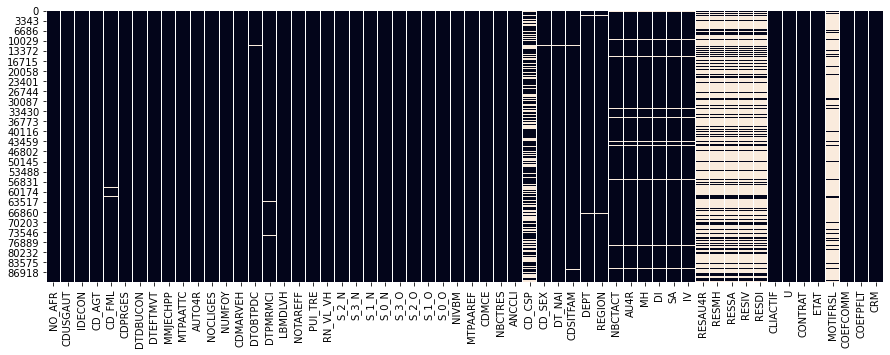

In [17]:
plt.figure(figsize=(15,5))
sns.heatmap(data.isnull(), cbar=False)

In [18]:
data=data.drop(["MOTIFRSL","CD_CSP"],axis=1)

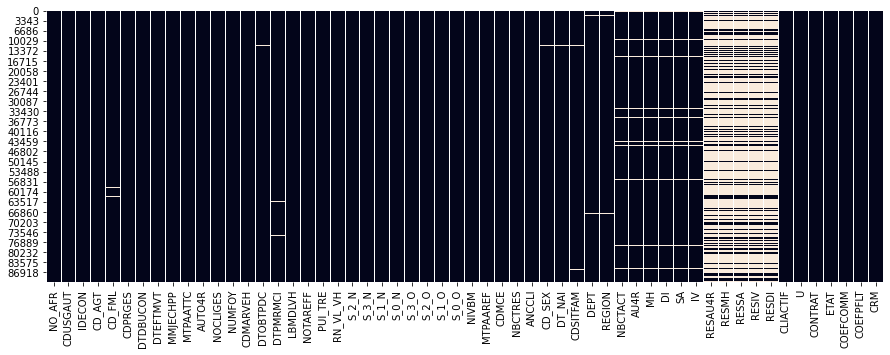

In [19]:
plt.figure(figsize=(15,5))
sns.heatmap(data.isnull(), cbar=False)

In [20]:
#SUPPRESSION DES DATE DE DEBUT DE CONTRAT AVANT 1955 CAR PEU SIGNIFICATIF ET REPR2SENTATIF
data=data[data["DTDBUCON"].dt.year>=1955]

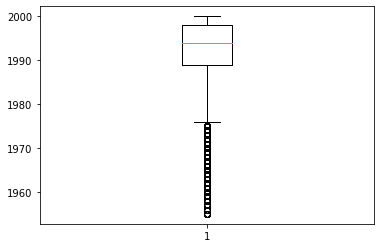

In [21]:
plt.boxplot(data["DTDBUCON"].dt.year);

In [22]:
#Suppression des variables inutiles
data=data.drop(["AUTO4R","LBMDLVH","DEPT","NO_AFR", "IDECON" , "MMJECHPP"],axis=1)

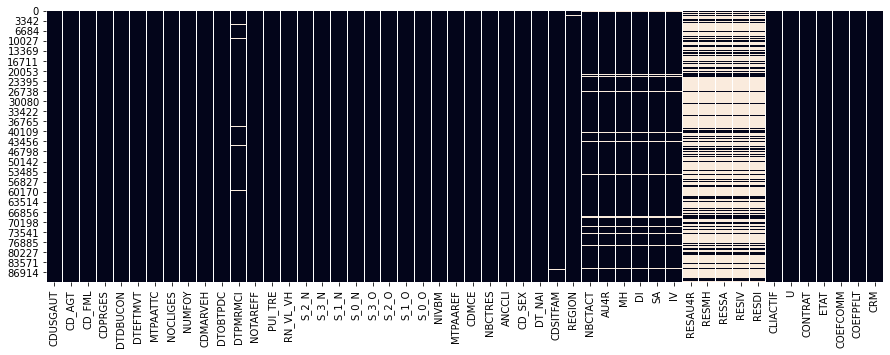

In [23]:
plt.figure(figsize=(15,5))
sns.heatmap(data.isnull(), cbar=False)

In [24]:
#Si le nombre de contrats actifs / contrats resiliés  vaut 0 remplacement des nan
col_resiliation=data.columns[data.columns.str.startswith("RES")]
for i in col_resiliation: 
  data.loc[(data["NBCTRES"]==0)&(data[i].isna()),i]=0
data["NBCTACT"]=data["NBCTACT"].fillna(0)
for i in ["SA","IV","MH","DI","AU4R"]:
  data.loc[(data["NBCTACT"]==0)&(data[i].isna()),i]=0

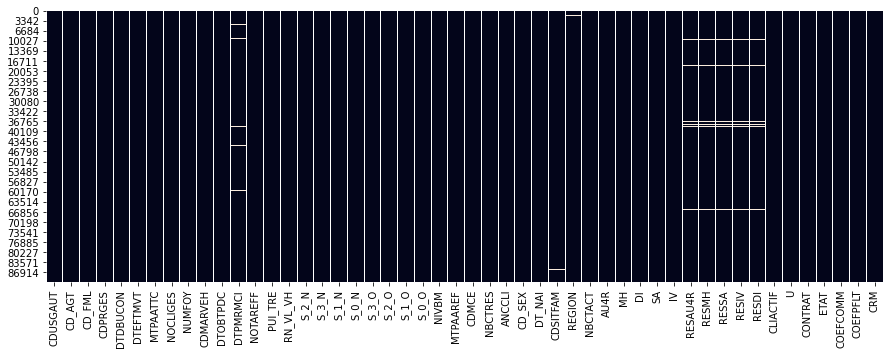

In [25]:
plt.figure(figsize=(15,5))
sns.heatmap(data.isnull(), cbar=False)

In [27]:
#Pour ceux qui ont au moins un contrat ou contrat résilié
res_for_na=data[["NBCTRES","RESSA","RESIV","RESMH","RESDI","RESAU4R"]].groupby("NBCTRES").mean()+.4
res_for_na=res_for_na.astype(int)

for i in res_for_na.index :
  for j in ["RESSA","RESIV","RESMH","RESDI","RESAU4R"]:
    data.loc[(data["NBCTRES"]==i) & (data[j].isna()), j]=res_for_na.loc[i,j]

In [28]:
res_for_na

,RESSA,RESIV,RESMH,RESDI,RESAU4R
NBCTRES,,,,,
0.0,0,0,0,0,0
1.0,0,0,0,0,1
2.0,0,0,0,0,1
3.0,0,0,1,0,1
4.0,0,0,1,1,2
5.0,0,0,1,1,2
6.0,0,0,1,1,2
7.0,0,0,1,2,2
8.0,0,0,1,2,3


In [ ]:
data[num_var].describe()

,U,CDUSGAUT,MTPAATTC,RN_VL_VH,S_2_N,S_3_N,S_1_N,S_0_N,S_3_O,S_2_O,S_1_O,S_0_O,NIVBM,MTPAAREF,NBCTRES,NBCTACT,AU4R,MH,DI,SA,IV,RESAU4R,RESMH,RESSA,RESIV,RESDI
count,90225.000000,90209.000000,90225.000000,90055.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000,90225.000000
mean,0.501533,612.258744,3076.156293,7.886925,0.117307,0.100006,0.134619,0.129787,0.033306,0.041009,0.049532,0.051349,59.096858,5000.046526,0.471122,2.778676,1.526938,0.657224,0.256791,0.098642,0.062544,0.293056,0.080432,0.018631,0.000510,0.047681
std,0.288456,13.034335,1959.424764,3.724270,0.359436,0.335715,0.386802,0.376128,0.185568,0.205556,0.226327,0.231064,16.163672,3483.073160,0.868435,2.436003,1.016286,0.849251,0.749205,0.387620,0.480005,0.573784,0.309871,0.154859,0.024002,0.259525
min,0.000010,1.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,171.880000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.252170,609.000000,1774.260000,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,2742.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.502579,611.000000,2646.200000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,4139.000000,0.000000,2.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.750546,613.000000,3850.280000,10.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,64.000000,6167.000000,1.000000,3.000000,2.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,0.999973,670.000000,62556.820000,18.000000,4.000000,5.000000,5.000000,4.000000,5.000000,3.000000,3.000000,3.000000,289.000000,101296.000000,26.000000,43.000000,36.000000,19.000000,16.000000,8.000000,26.000000,12.000000,7.000000,5.000000,2.000000,7.000000


In [ ]:
sum(data["DT_NAI"].isnull())

208

In [ ]:
import datetime
from datetime import date

In [ ]:
# CALCUL DE L'AGE
data['AGE']=round((data['DTDBUCON'].dt.year - data['DT_NAI'].dt.year)-((data['DTDBUCON'].dt.month - data['DT_NAI'].dt.month) < 0))

In [ ]:
#REMPLACEMENT AGE nan PAR MOYENNE PAR DEBUT DE CONTRAT
data["YEAR_CON"]=data["DTDBUCON"].dt.year
lst_age=data[(data['AGE']>16)&(data['AGE']<100)].groupby("YEAR_CON")["AGE"].mean()

data['AGE']=data['AGE'].fillna(0)
for i in data.index:
  if ((data.loc[i,'AGE']<16) | (data.loc[i,'AGE']>100)):
    data.loc[i,'AGE']=lst_age.loc[data.loc[i,'YEAR_CON']]
data["AGE"]=data["AGE"].astype(int)    

In [ ]:
data['ANCCLI'].isnull().sum()
# peu de valeur manquante donc on peut mettre hypothese date premier contrat = date debut contrat actuel ?  

17

In [ ]:
# CALCUL DE L'Anciennete
data['Anciennete']=round((data['DTDBUCON'].dt.year - data['ANCCLI'].dt.year)-((data['DTDBUCON'].dt.month - data['ANCCLI'].dt.month) < 0))

In [ ]:
data["Anciennete"].unique()

array([ 0., 16.,  2.,  3.,  4., 19.,  1.,  5., 14.,  9., 12., 28., 15.,
       22., 10., 11., 18.,  8.,  7., 13.,  6., 23., 25., 21., 30., 20.,
       nan, 17., 29., 66., 26., 38., 33., 27., 32., 24., 35., 37., 39.,
       43., 34., 36., 31., 42., 40., 77., 61., 92., 60., 64., 89., 95.,
       99., 82., 83., 90., 88., 96., 41., 46., 62., 68., 84., 86., 87.,
       51., 75., 48., 93., 52., 49., 91., 80., 98., 57., 50., 97., 74.,
       67., 71., 76., 81., 78., 94., 45., 85., 65., 53., 79., 44., 73.,
       69., 72.])

In [ ]:
data[(data['Anciennete']==0)].shape

In [ ]:
data[(data['Anciennete']==0) & (data['ANCCLI']!=data['DTDBUCON'])].shape
# 12299 individu dont l'anciennete < 1 an

(12299, 53)

In [ ]:
# remplace NAN par DTDBUCON
data.ANCCLI.fillna(data.DTDBUCON, inplace=True)

In [ ]:
(data["DTDBUCON"]-data["DTPMRMCI"])/np.timedelta64(1,"D")
#(data["DTDBUCON"]-data["DTPMRMCI"])/np.timedelta64(1,"W") week
#(data["DTDBUCON"]-data["DTPMRMCI"])/np.timedelta64(1,"M") Month



# Brouillon


In [ ]:
data[data['ANCCLI'].isna()][["NBCTACT","NBCTRES","DTDBUCON","AU4R","S_0_N","S_1_N","S_2_N","S_3_N","S_0_O","S_1_O","S_2_O","S_3_O"]]

,NBCTACT,NBCTRES,DTDBUCON,AU4R,S_0_N,S_1_N,S_2_N,S_3_N,S_0_O,S_1_O,S_2_O,S_3_O
215,1.0,0.0,1999-12-10,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8211,1.0,0.0,1999-11-15,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
12831,1.0,0.0,1999-12-08,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
16965,2.0,0.0,1999-01-12,2.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
23235,2.0,0.0,1988-09-17,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27395,1.0,0.0,1984-05-24,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
27579,0.0,1.0,2000-06-27,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
30674,2.0,0.0,1999-05-31,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
34170,3.0,1.0,1999-12-05,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
43068,1.0,0.0,1999-07-16,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# Nouvelle section

In [ ]:
pd.Series(y2).value_counts()

1999    9027
1998    8164
1997    7651
2000    7487
1992    6061
1996    5812
1995    4966
1991    4742
1994    4656
1993    4645
1990    3163
1984    3069
1985    2943
1989    2414
1988    2173
1987    2149
1986    2138
1983    1751
1982    1053
1981     964
1980     870
1979     708
1978     449
1977     257
1971     217
1974     206
1976     204
1975     198
1973     192
1970     191
1969     175
1972     157
1968     155
1966     152
1967     146
1965     142
1964     137
1963     123
1962     116
1961     103
1960      94
1959      66
1958      58
1957      46
1956      22
1955      13
1953       4
1954       4
1950       3
1951       3
1901       2
1939       1
1929       1
1947       1
1949       1
1952       1
1946       1
dtype: int64

In [ ]:
temp

0        [1969, 12, 18 00:00:00]
1        [1976, 09, 06 00:00:00]
2        [1937, 01, 10 00:00:00]
3        [1981, 08, 22 00:00:00]
4        [1950, 01, 20 00:00:00]
                  ...           
90242    [1959, 10, 27 00:00:00]
90243    [1965, 12, 21 00:00:00]
90244    [1967, 05, 26 00:00:00]
90245    [1978, 02, 22 00:00:00]
90246    [1968, 09, 02 00:00:00]
Name: DT_NAI, Length: 90247, dtype: object

In [ ]:
data[(data['AGE']<15)][["DTDBUCON","DT_NAI",'AGE']].head(10)

,DTDBUCON,DT_NAI,AGE
407,1991-12-19,1979-10-26 00:00:00,12
978,1971-01-01,1957-11-01 00:00:00,14
2228,1990-02-01,1979-11-12 00:00:00,11
2269,1992-01-01,1979-08-03 00:00:00,13
2773,1993-07-30,1982-07-20 00:00:00,11
4059,1989-03-24,1980-12-31 00:00:00,9
4351,1959-01-07,1947-11-02 00:00:00,12
5336,1990-09-07,1976-09-07 00:00:00,14
5816,1964-05-01,1965-11-29 00:00:00,-1
7562,1987-08-26,1973-07-19 00:00:00,14


In [ ]:
data[(data['AGE']<15)|(data['AGE']>100)]

,NO_AFR,CDUSGAUT,IDECON,CD_AGT,CD_FML,CDPRGES,DTDBUCON,DTEFTMVT,MMJECHPP,MTPAATTC,...,RESDI,CLIACTIF,U,CONTRAT,ETAT,MOTIFRSL,COEFCOMM,COEFPFLT,CRM,AGE
212,A00125991421427,611.0,5691230,A00125,S,4190A,1999-10-01,2000-07-01,1001,2334.00,...,NaN,OUI,0.316760,ACTIF,CO,NaN,95,0.85,76,1999
261,A00159001229993,611.0,305857573,A00159,D,4190A,2000-02-03,2000-08-07,0301,7860.40,...,0.0,OUI,0.901559,RESIL,RL,08,95,1,100,2000
278,A00159901220785,611.0,100044811,A00159,C,4190A,1990-01-20,2000-08-03,0107,4336.50,...,0.0,NON,0.813107,RESIL,RL,98,100,0.93,57,1990
407,A00208911614943,613.0,300049283,A00208,C,4190A,1991-12-19,2000-06-19,1219,1850.04,...,NaN,OUI,0.232118,ACTIF,CO,NaN,95,1.0252,64,12
569,A00227891047495,668.0,100053591,A00227,NaN,4190A,1989-01-05,2000-07-07,0107,455.88,...,NaN,OUI,0.591837,ACTIF,CO,NaN,100,0.9682,0,1989
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
88419,A28413921481482,604.0,403243814,A28413,E,4190A,1992-07-02,2000-07-02,0702,917.56,...,NaN,OUI,0.526361,ACTIF,CO,NaN,100,1.013,50,1992
88535,A28421000030749,624.0,3246230,A28421,S,4190A,1962-02-01,2000-02-13,0213,911.36,...,NaN,OUI,0.950254,ACTIF,CO,NaN,100,1,50,12
89102,A28814981266668,611.0,504941945,A28814,S,4190A,1998-03-31,2000-03-31,0331,1567.84,...,NaN,OUI,0.016626,ACTIF,CO,NaN,100,0.9497,52,1998
89412,A31346991294539,641.0,605497346,A31346,R,4190A,1999-04-19,2000-08-31,0831,4017.13,...,0.0,OUI,0.089490,RESIL,RL,01,100,0.8621,50,1999


In [ ]:
data.loc[75937,date]

DTDBUCON    1901-01-01 00:00:00
DTEFTMVT    2000-06-07 00:00:00
DTOBTPDC    1951-12-01 00:00:00
DTPMRMCI    1989-09-01 00:00:00
ANCCLI      1901-01-01 00:00:00
DT_NAI      1931-12-01 00:00:00
Name: 75937, dtype: object

In [ ]:
data.loc[5816,date]

DTDBUCON    1964-05-01 00:00:00
DTEFTMVT    2000-10-07 00:00:00
DTOBTPDC    1984-06-01 00:00:00
DTPMRMCI    1988-12-01 00:00:00
ANCCLI      1964-05-01 00:00:00
DT_NAI      1965-11-29 00:00:00
Name: 5816, dtype: object

In [ ]:
data[data["DT_NAI"].astype(float)<0][["DT_NAI","DTDBUCON"]]

,DT_NAI,DTDBUCON
2,-8391,14848
4,-3633,4018
5,-12022,6993
6,-8407,7185
8,-11749,8529
...,...,...
90237,-13694,8274
90238,-1829,10000
90239,-6097,11427
90240,-6097,11445


In [ ]:
pd.Series(y2)-pd.Series(y)

0        31
1        24
2        63
3        19
4        21
         ..
90242    37
90243    31
90244    32
90245    21
90246    23
Length: 90247, dtype: int64

In [ ]:
data

,CDUSGAUT,CD_AGT,CD_FML,CDPRGES,DTDBUCON,DTEFTMVT,MTPAATTC,NOCLIGES,NUMFOY,CDMARVEH,...,RESSA,RESIV,RESDI,CLIACTIF,U,CONTRAT,ETAT,COEFCOMM,COEFPFLT,CRM
0,611.0,A00104,R,4190A,2000-01-21,2000-07-21,1929.66,11852135,11852135,PEUGEOT,...,NaN,NaN,NaN,OUI,0.630638,ACTIF,CO,100,0.85,50
1,636.0,A00104,C,4190A,2000-04-01,2000-04-01,4106.44,12024026,12024026,PEUGEOT,...,NaN,NaN,NaN,OUI,0.012901,ACTIF,CO,100,0.75,76
2,611.0,A00104,C,4190A,2000-08-26,2000-08-26,4821.80,11154377,9064205,PEUGEOT,...,0.0,0.0,0.0,OUI,0.417773,ACTIF,CO,100,0.9,95
3,611.0,A00104,C,4190A,2000-09-08,2000-09-08,9460.74,10342979,10342979,RENAULT,...,0.0,0.0,0.0,OUI,0.508437,ACTIF,CO,100,0.9,95
4,603.0,A00104,S,4190A,1971-01-01,2000-04-07,1530.09,8826057,8289285,MERCEDES,...,NaN,NaN,NaN,OUI,0.615430,ACTIF,CO,91,0.8065,50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
90242,609.0,L00004,S,4190A,1996-07-10,2000-07-10,1290.36,6095880,6095880,FORD,...,NaN,NaN,NaN,OUI,0.818691,ACTIF,CO,100,0.9562,50
90243,611.0,L00004,C,4190A,1996-12-21,1998-06-21,2521.50,9564026,9564026,CITROEN,...,NaN,NaN,NaN,OUI,0.062532,ACTIF,CO,98,0.81,66
90244,611.0,L00004,C,4190A,1999-04-01,1999-04-01,1814.34,3151379,3151379,PEUGEOT,...,0.0,0.0,0.0,OUI,0.505506,ACTIF,CO,95,0.8837,51
90245,613.0,L00004,C,4190A,1999-08-18,2000-08-18,2700.12,9667724,9667724,PEUGEOT,...,NaN,NaN,NaN,OUI,0.821757,ACTIF,CO,77,1.0119,85


In [ ]:
yy=[]
for i in y:
    yy.append(int(i))

ValueError: invalid literal for int() with base 10: 'NaT'

In [ ]:
test

0        [1969, 12, 18]
1        [1976, 09, 06]
2        [1937, 01, 10]
3        [1981, 08, 22]
4        [1950, 01, 20]
              ...      
90242    [1959, 10, 27]
90243    [1965, 12, 21]
90244    [1967, 05, 26]
90245    [1978, 02, 22]
90246    [1968, 09, 02]
Name: DT_NAI, Length: 90247, dtype: object

In [ ]:
test.apply( lambda x : return int(x[0]) ) 

SyntaxError: invalid syntax (<ipython-input-166-d8c62335015e>, line 1)

In [ ]:
data["DT_NAI"].split('/')

AttributeError: Can only use .str accessor with string values!

In [ ]:
def days_diff(date_1, date_2):
    """date of type 15/05/1972"""
    return abs((parse(date_1) - parse(date_2)).days)
 

AttributeError: module 'datetime' has no attribute 'strptime'

In [ ]:
data["DT_NAI"].month()

AttributeError: 'Series' object has no attribute 'month'

In [ ]:
pd.crosstab(data["RESSA"].fillna(-1),data["SA"].fillna(-1))

SA,-1.0,0.0,1.0,2.0,3.0,4.0,5.0,6.0,8.0
RESSA,,,,,,,,,
-1.0,0,59549,3393,606,142,42,7,2,0
0.0,4522,18459,1568,364,83,28,7,0,1
1.0,43,722,358,121,40,14,3,2,1
2.0,7,69,37,15,12,3,1,0,0
3.0,0,8,3,5,1,0,0,0,0
4.0,0,3,3,1,0,0,0,0,0
5.0,0,0,1,0,1,0,0,0,0


In [ ]:
data["SA"].fillna(-1).value_counts(normalize=True).head(20)

 0.0    0.873270
 1.0    0.059426
-1.0    0.050661
 2.0    0.012322
 3.0    0.003092
 4.0    0.000964
 5.0    0.000199
 6.0    0.000044
 8.0    0.000022
Name: SA, dtype: float64

In [ ]:
data["DEPT"].nunique()

100

In [ ]:
data["NUMFOY"].value_counts().head(20)

4742292     5
11769284    4
10304652    4
3956119     4
3099394     4
5911877     4
7772175     4
7112556     4
7141090     4
2114916     3
5084978     3
7663357     3
6251843     3
3107429     3
6763718     3
5220195     3
3693229     3
8600603     3
2531205     3
7600069     3
Name: NUMFOY, dtype: int64

In [ ]:
data["NOCLIGES"].nunique()

88018

In [ ]:
col_to_date=['DTDBUCON','DTEFTMVT','DTOBTPDC','DTPMRMCI','DT_NAI','ANCCLI','MMJECHPP']

for col in col_to_date:
    df[col]=pd.to_datetime(df[col], unit='D',errors='coerce',
               origin=pd.Timestamp('1960-01-01'))

In [ ]:
for i in range(len(col_year)):
    df[col_to_date[i]+'_YEAR']=df[col_to_date[i]].dt.year

In [ ]:
data['REGION'].value_counts()

NE    20170
SO    17207
MM    14847
OU    14640
PA    11656
RA    11490
00       16
97       15
98        5
GU        1
99        1
Name: REGION, dtype: int64

In [ ]:
data['LBMDLVH'].value_counts(normalize=True)

205              0.051322
CLIO             0.049680
R 5 SUPERCINQ    0.028168
R19              0.023875
306              0.023753
                   ...   
525 I HD61A5F    0.000011
RH SAVANE        0.000011
JUVA 4           0.000011
AX ZAZT          0.000011
IMAGE            0.000011
Name: LBMDLVH, Length: 6806, dtype: float64

In [ ]:
sum(data['NOCLIGES']==data['NUMFOY'])/len(data)

0.8842842421354726

In [ ]:
data['NUMFOY'].value_counts().head(50)

4742292     5
10304652    4
7112556     4
7141090     4
3956119     4
5911877     4
3099394     4
11769284    4
7772175     4
8688689     3
1612403     3
10401705    3
7219579     3
9419983     3
4987464     3
1672965     3
5220195     3
1840403     3
893160      3
3074669     3
9879825     3
5018799     3
3850840     3
6563399     3
7594729     3
3345286     3
7402135     3
3693229     3
7600069     3
2531205     3
3451044     3
5481730     3
6397894     3
8126833     3
3142661     3
1295597     3
4026616     3
6275236     3
1066014     3
8512144     3
8479945     3
6582270     3
7592357     3
129291      3
843404      3
4523391     3
11984303    3
10147295    3
11916574    3
3236154     3
Name: NUMFOY, dtype: int64

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
data.shape

(90247, 58)

<AxesSubplot:>

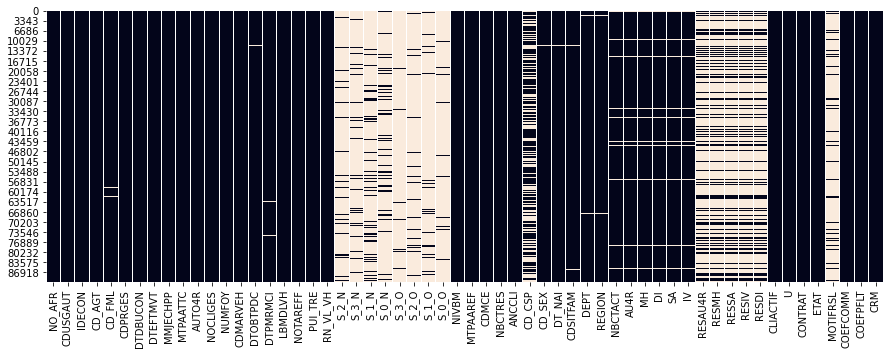

In [ ]:
plt.figure(figsize=(15,5))
sns.heatmap(data.isnull(), cbar=False)

In [ ]:
data.columns[data.isna().sum() > len(data)*.3]

Index(['S_2_N', 'S_3_N', 'S_1_N', 'S_0_N', 'S_3_O', 'S_2_O', 'S_1_O', 'S_0_O',
       'CD_CSP', 'RESAU4R', 'RESMH', 'RESSA', 'RESIV', 'RESDI', 'MOTIFRSL'],
      dtype='object')

In [ ]:
pd.crosstab(data["RESMH"].fillna(-1),data["MH"].fillna(-1))

MH,-1.0,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,10.0,11.0,12.0,13.0,14.0,16.0,17.0,19.0
RESMH,,,,,,,,,,,,,,,,,,,
-1.0,0,31300,26966,4036,924,312,100,47,28,6,12,4,4,1,0,1,0,0,0
0.0,3741,6174,7830,1581,463,160,58,23,13,6,1,5,6,2,1,0,0,0,0
1.0,765,2226,1833,607,218,93,33,17,9,7,1,0,0,0,1,0,1,0,0
2.0,54,159,181,76,21,18,11,2,2,0,1,0,1,0,0,0,0,0,1
3.0,6,24,25,8,7,6,3,1,0,0,0,0,0,0,0,0,0,0,0
4.0,0,3,1,0,2,1,1,2,0,0,0,0,0,0,0,0,0,2,0
5.0,3,0,3,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
6.0,3,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
7.0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
pd.crosstab(data["CONTRAT"].fillna(-1),data["CLIACTIF"].fillna(-1), normalize=True)

CLIACTIF,NON,OUI
CONTRAT,,
ACTIF,0.000000,0.887753
RESIL,0.050661,0.061587


In [ ]:
sum(data["CRM"].astype(float)==data["NIVBM"])

90247

In [ ]:
#On peut sommer les nombre de sinistres ou on peut aussi remplacer le NaN par des 0.
(data["S_2_N"].fillna(0.0)+data["S_2_O"].fillna(0.0)).value_counts(dropna=False,normalize=True)

0.0    0.862145
1.0    0.119494
2.0    0.016466
3.0    0.001740
4.0    0.000122
5.0    0.000033
dtype: float64

In [ ]:
data["S_1_O"].value_counts(dropna=False,normalize=True)

NaN    0.952530
1.0    0.045442
2.0    0.002006
3.0    0.000022
Name: S_1_O, dtype: float64

In [ ]:
data["S_1_N"].value_counts(dropna=False,normalize=True)

NaN    0.880561
1.0    0.105499
2.0    0.012787
3.0    0.001064
4.0    0.000078
5.0    0.000011
Name: S_1_N, dtype: float64

In [ ]:
data["CD_CSP"].value_counts(dropna=False,normalize=True)

NaN     0.439483
5       0.140692
7       0.111018
52      0.034106
1       0.032533
          ...   
6244    0.000011
5216    0.000011
3724    0.000011
3829    0.000011
2243    0.000011
Name: CD_CSP, Length: 235, dtype: float64

In [ ]:
data["RESMH"].value_counts(dropna=False,normalize=True)

NaN    0.706295
0.0    0.222323
1.0    0.064390
2.0    0.005840
3.0    0.000886
4.0    0.000133
5.0    0.000066
6.0    0.000055
7.0    0.000011
Name: RESMH, dtype: float64

In [ ]:
data["S_3_N"].value_counts(dropna=False)

NaN    82150
1.0     7260
2.0      753
3.0       79
4.0        4
5.0        1
Name: S_3_N, dtype: int64

In [ ]:
S_2_N S_3_N

In [ ]:
data["CD_CSP"].value_counts(dropna=False)

NaN     39662
5       12697
7       10019
52       3078
1        2936
        ...  
6244        1
5216        1
3724        1
3829        1
2243        1
Name: CD_CSP, Length: 235, dtype: int64

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90247 entries, 0 to 90246
Data columns (total 58 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   NO_AFR    90247 non-null  object 
 1   CDUSGAUT  90231 non-null  float64
 2   IDECON    90247 non-null  object 
 3   CD_AGT    90247 non-null  object 
 4   CD_FML    89702 non-null  object 
 5   CDPRGES   90247 non-null  object 
 6   DTDBUCON  90247 non-null  float64
 7   DTEFTMVT  90247 non-null  float64
 8   MMJECHPP  90231 non-null  object 
 9   MTPAATTC  90247 non-null  float64
 10  AUTO4R    90247 non-null  object 
 11  NOCLIGES  90247 non-null  object 
 12  NUMFOY    90247 non-null  object 
 13  CDMARVEH  90160 non-null  object 
 14  DTOBTPDC  90054 non-null  float64
 15  DTPMRMCI  89315 non-null  float64
 16  LBMDLVH   90137 non-null  object 
 17  NOTAREFF  89980 non-null  object 
 18  PUI_TRE   90081 non-null  object 
 19  RN_VL_VH  90077 non-null  float64
 20  S_2_N     9512 non-null   fl

In [ ]:
data[date]

,DTDBUCON,DTEFTMVT,DTOBTPDC,DTPMRMCI,DT_NAI
0,14630,14812,10273,10683,3639
1,14701,14701,12877,11262,6093
2,14848,14848,14196,9678,-8391
3,14861,14861,14629,11870,7904
4,4018,14707,NaN,5935,-3633
...,...,...,...,...,...
90242,13340,14801,11197,11323,-66
90243,13504,14051,9212,10624,2181
90244,14335,14335,9303,10897,2702
90245,14474,14840,13559,10593,6627


In [ ]:
data["ANCCLI"]

0        14598.0
1        14701.0
2         8866.0
3        13872.0
4         4018.0
          ...   
90242    13340.0
90243    13504.0
90244    11401.0
90245    13590.0
90246    11578.0
Name: ANCCLI, Length: 90247, dtype: float64

In [ ]:
import time

In [ ]:
datetime=3639
datetime.date.fromtimestamp(time.time())

AttributeError: 'int' object has no attribute 'date'

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90247 entries, 0 to 90246
Data columns (total 58 columns):
 #   Column    Non-Null Count  Dtype  
---  ------    --------------  -----  
 0   NO_AFR    90247 non-null  object 
 1   CDUSGAUT  90231 non-null  float64
 2   IDECON    90247 non-null  object 
 3   CD_AGT    90247 non-null  object 
 4   CD_FML    89702 non-null  object 
 5   CDPRGES   90247 non-null  object 
 6   DTDBUCON  90247 non-null  object 
 7   DTEFTMVT  90247 non-null  object 
 8   MMJECHPP  90231 non-null  object 
 9   MTPAATTC  90247 non-null  float64
 10  AUTO4R    90247 non-null  object 
 11  NOCLIGES  90247 non-null  object 
 12  NUMFOY    90247 non-null  object 
 13  CDMARVEH  90160 non-null  object 
 14  DTOBTPDC  90054 non-null  object 
 15  DTPMRMCI  89315 non-null  object 
 16  LBMDLVH   90137 non-null  object 
 17  NOTAREFF  89980 non-null  object 
 18  PUI_TRE   90081 non-null  object 
 19  RN_VL_VH  90077 non-null  float64
 20  S_2_N     9512 non-null   fl

In [ ]:
data["DT_NAI"]

0         3639
1         6093
2        -8391
3         7904
4        -3633
         ...  
90242      -66
90243     2181
90244     2702
90245     6627
90246     3167
Name: DT_NAI, Length: 90247, dtype: object

In [ ]:
data.shape
# CDPRGES ETAT U CLIACTIF (client actif) MOTIFRSL (motif résiliation)  COEFCOMM (coef commision ??)  COEFPFLT  CRM   NO_AFR

(90247, 58)

In [ ]:
data.iloc[:10,].head(10)

,NO_AFR,CDUSGAUT,IDECON,CD_AGT,CD_FML,CDPRGES,DTDBUCON,DTEFTMVT,MMJECHPP,MTPAATTC,...,RESIV,RESDI,CLIACTIF,U,CONTRAT,ETAT,MOTIFRSL,COEFCOMM,COEFPFLT,CRM
0,A00104001204707,611,205808992,A00104,R,4190A,14630,14812,0121,1929.66,...,NaN,NaN,OUI,0.63063826581027,ACTIF,CO,NaN,100,0.85,50
1,A00104001270809,636,105939601,A00104,C,4190A,14701,14701,0401,4106.44,...,NaN,NaN,OUI,0.012900575535791,ACTIF,CO,NaN,100,0.75,76
2,A00104001397301,611,306115473,A00104,C,4190A,14848,14848,0826,4821.8,...,0,0,OUI,0.41777253310092,ACTIF,CO,NaN,100,0.9,95
3,A00104001402563,611,206122172,A00104,C,4190A,14861,14861,0908,9460.74,...,0,0,OUI,0.5084374372421,ACTIF,CO,NaN,100,0.9,95
4,A00104716130632,603,35070,A00104,S,4190A,4018,14707,0407,1530.09,...,NaN,NaN,OUI,0.61543046106372,ACTIF,CO,NaN,91,0.8065,50
5,A00104797003762,603,700035247,A00104,T,4190A,6993,14707,0407,2399.44,...,NaN,NaN,OUI,0.70681552808118,ACTIF,CO,NaN,88,0.9965,50
6,A00104797033990,611,500035255,A00104,C,4190A,7185,14707,1007,1342.84,...,NaN,NaN,OUI,0.45661604286014,ACTIF,CO,NaN,92,0.9716,50
7,A00104826377557,611,600035396,A00104,S,4190A,8079,14737,0507,1379.3,...,NaN,NaN,OUI,0.61012675222481,ACTIF,CO,NaN,95,1.1221,50
8,A00104837504989,603,500035455,A00104,T,4190A,8529,14798,0707,4377.48,...,NaN,NaN,OUI,0.84261807698878,ACTIF,CO,NaN,100,0.943,50
9,A00104841211455,611,35490,A00104,D,4190A,9066,14341,1007,1575.8,...,NaN,NaN,OUI,0.85835207805892,ACTIF,CO,NaN,100,1.0053,50


In [ ]:
data.info()

NameError: ignored

In [ ]:
with open('/Users/alissadjema/Desktop/M2TIDE/S2/scoring/ResiliationContratAuto/ResiliationContratAuto.csv', 'rb') as fichier:
    contenu = fichier.read()

TypeError: read() takes no keyword arguments

In [ ]:
contenu

b'NO_AFR|CDUSGAUT|IDECON|CD_AGT|CD_FML|CDPRGES|DTDBUCON|DTEFTMVT|MMJECHPP|MTPAATTC|AUTO4R|NOCLIGES|NUMFOY|CDMARVEH|DTOBTPDC|DTPMRMCI|LBMDLVH|NOTAREFF|PUI_TRE|RN_VL_VH|S_2_N|S_3_N|S_1_N|S_0_N|S_3_O|S_2_O|S_1_O|S_0_O|NIVBM|MTPAAREF|CDMCE|NBCTRES|ANCCLI|CD_CSP|CD_SEX|DT_NAI|CDSITFAM|DEPT|REGION|NBCTACT|AU4R|MH|DI|SA|IV|RESAU4R|RESMH|RESSA|RESIV|RESDI|CLIACTIF|U|CONTRAT|ETAT|MOTIFRSL|COEFCOMM|COEFPFLT|CRM\r\nA00104001204707|611|205808992|A00104|R|4190A|14630|14812|0121|1929.66|O|11852135|11852135|PEUGEOT|10273|10683|205|BL050|D|05|||||||||50|3833|P|0|14598||F|3639|M|01|RA|1|1|0|0|0|0||||||OUI|0.63063826581027|ACTIF|CO||100|0.85|50\r\nA00104001270809|636|105939601|A00104|C|4190A|14701|14701|0401|4106.44|O|12024026|12024026|PEUGEOT|12877|11262|309|BL064|K|10|||||||||76|5991|P|0|14701||M|6093|M|01|RA|1|1|0|0|0|0||||||OUI|0.012900575535791|ACTIF|CO||100|0.75|76\r\nA00104001397301|611|306115473|A00104|C|4190A|14848|14848|0826|4821.8|O|11154377|9064205|PEUGEOT|14196|9678|104|BL100|W|04|||||||||9

In [ ]:
df = pd.read_csv('/Users/alissadjema/Desktop/M2TIDE/S2/scoring/ResiliationContratAuto/ResiliationContratAuto.csv',sep="|")

UnicodeDecodeError: 'utf-8' codec can't decode byte 0xb7 in position 4: invalid start byte

In [ ]:
auto=open('/Users/alissadjema/Desktop/M2TIDE/S2/scoring/ResiliationContratAuto/ResiliationContratAuto.csv','r')


FileNotFoundError: [Errno 2] No such file or directory: '/Users/alissadjema/Desktop/M2TIDE/S2/scoring/ResiliationContratAuto/ResiliationContratAuto.csv'

In [ ]:
dt = auto.read_file()

AttributeError: '_io.TextIOWrapper' object has no attribute 'read_file'

In [ ]:
auto=read('/Users/alissadjema/Desktop/M2TIDE/S2/scoring/ResiliationContratAuto/ResiliationContratAuto.txt','r')


NameError: name 'read' is not defined

In [ ]:
loc_file = r'/Users/alissadjema/Desktop/M2TIDE/S2/scoring/ResiliationContratAuto/ResiliationContratAuto.csv' # Remplacez par votre chemin d'accès aux données
df = pd.read_csv('/Users/alissadjema/Desktop/M2TIDE/S2/scoring/ResiliationContratAuto/ResiliationContratAuto.csv',sep="|")

FileNotFoundError: [Errno 2] No such file or directory: '/Users/alissadjema/Desktop/M2TIDE/S2/scoring/ResiliationContratAuto/ResiliationContratAuto.csv'

In [ ]:
data["DT_NAI"].head(10)

0      3639
1      6093
2     -8391
3      7904
4     -3633
5    -12022
6     -8407
7       700
8    -11749
9      2472
Name: DT_NAI, dtype: object

In [ ]:
data["MMJECHPP"].head(10)

0    0121
1    0401
2    0826
3    0908
4    0407
5    0407
6    1007
7    0507
8    0707
9    1007
Name: MMJECHPP, dtype: object

In [ ]:
data["DTDBUCON"].head(10)

0    14630
1    14701
2    14848
3    14861
4     4018
5     6993
6     7185
7     8079
8     8529
9     9066
Name: DTDBUCON, dtype: object

In [ ]:
#différence entre date de mise en circulation du vehicule et date de début du contrat 
#Négative ? 

int(data["DTPMRMCI"][50])-int(data["DTDBUCON"][50])

-2696